# Session 4: Visualizing Representations
<p class='lead'>
Creative Applications of Deep Learning with Google's Tensorflow  
Parag K. Mital  
Kadenze, Inc.
</p>

<a name="learning-goals"></a>
## Learning Goals

* Learn how to inspect deep networks by visualizing their gradients
* Learn how to "deep dream" with different objective functions and regularization techniques
* Learn how to "stylize" an image using content and style losses from different images

<!-- MarkdownTOC autolink=true autoanchor=true bracket=round -->

- [Introduction](#introduction)
- [Deep Convolutional Networks](#deep-convolutional-networks)
    - [Loading a Pretrained Network](#loading-a-pretrained-network)
    - [Predicting with the Inception Network](#predicting-with-the-inception-network)
    - [Visualizing Filters](#visualizing-filters)
    - [Visualizing the Gradient](#visualizing-the-gradient)
- [Deep Dreaming](#deep-dreaming)
    - [Simplest Approach](#simplest-approach)
    - [Specifying the Objective](#specifying-the-objective)
    - [Decaying the Gradient](#decaying-the-gradient)
    - [Blurring the Gradient](#blurring-the-gradient)
    - [Clipping the Gradient](#clipping-the-gradient)
    - [Infinite Zoom / Fractal](#infinite-zoom--fractal)
    - [Laplacian Pyramid](#laplacian-pyramid)
- [Style Net](#style-net)
    - [VGG Network](#vgg-network)
    - [Dropout](#dropout)
    - [Defining the Content Features](#defining-the-content-features)
    - [Defining the Style Features](#defining-the-style-features)
    - [Remapping the Input](#remapping-the-input)
    - [Defining the Content Loss](#defining-the-content-loss)
    - [Defining the Style Loss](#defining-the-style-loss)
    - [Defining the Total Variation Loss](#defining-the-total-variation-loss)
    - [Training](#training)
- [Homework](#homework)
- [Reading](#reading)

<!-- /MarkdownTOC -->

<a name="introduction"></a>
# Introduction

So far, we've seen that a deep convolutional network can get very high accuracy in classifying the MNIST dataset, a dataset of handwritten digits numbered 0 - 9.  What happens when the number of classes grows higher than 10 possibilities?  Or the images get much larger?  We're going to explore a few new datasets and bigger and better models to try and find out.  We'll then explore a few interesting visualization tehcniques to help us understand what the networks are representing in its deeper layers and how these techniques can be used for some very interesting creative applications.

<a name="deep-convolutional-networks"></a>
# Deep Convolutional Networks

Almost 30 years of computer vision and machine learning research based on images takes an approach to processing images like what we saw at the end of Session 1: you take an image, convolve it with a set of edge detectors like the gabor filter we created, and then find some thresholding of this image to find more interesting features, such as corners, or look at histograms of the number of some orientation of edges in a particular window.  In the previous session, we started to see how Deep Learning has allowed us to move away from hand crafted features such as Gabor-like filters to letting data discover representations.  Though, how well does it scale?

A seminal shift in the perceived capabilities of deep neural networks occurred in 2012.  A network dubbed AlexNet, after its primary author, Alex Krizevsky, achieved remarkable performance on one of the most difficult computer vision datasets at the time, ImageNet.  <TODO: Insert montage of ImageNet>.  ImageNet is a dataset used in a yearly challenge called the ImageNet Large Scale Visual Recognition Challenge (ILSVRC), started in 2010.  The dataset contains nearly 1.2 million images composed of 1000 different types of objects.  Each object has anywhere between 600 - 1200 different images.  <TODO: Histogram of object labels>

Up until now, the most number of labels we've considered is 10!  The image sizes were also very small, only 28 x 28 pixels, and it didn't even have color.

Let's look at a state-of-the-art network that has already been trained on ImageNet.

<a name="loading-a-pretrained-network"></a>
## Loading a Pretrained Network

We can use an existing network that has been trained by loading the model's weights into a network definition.  The network definition is basically saying what are the set of operations in the tensorflow graph.  So how is the image manipulated, filtered, in order to get from an input image to a probability saying which 1 of 1000 possible objects is the image describing?  It also restores the model's weights.  Those are the values of every parameter in the network learned through gradient descent.  Luckily, many researchers are releasing their model definitions and weights so we don't have to train them!  We just have to load them up and then we can use the model straight away.  That's very lucky for us because these models take a lot of time, cpu, memory, and money to train.

To get the files required for these models, you'll need to download them from the resources page.

First, let's import some necessary libraries.

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import IPython.display as ipyd
from libs import gif, nb_utils

In [2]:
# Bit of formatting because I don't like the default inline code style:
from IPython.core.display import HTML
HTML("""<style> .rendered_html code { 
    padding: 2px 4px;
    color: #c7254e;
    background-color: #f9f2f4;
    border-radius: 4px;
} </style>""")

Start an interactive session:

In [3]:
sess = tf.InteractiveSession()

Now we'll load Google's Inception model, which is a pretrained network for classification built using the ImageNet database.  I've included some helper functions for getting this model loaded and setup w/ Tensorflow.

In [4]:
from libs import inception
net = inception.get_inception_model()

Here's a little extra that wasn't in the lecture.  We can visualize the graph definition using the `nb_utils` module's `show_graph` function.  This function is taken from an example in the Tensorflow repo so I can't take credit for it!  It uses Tensorboard, which we didn't get a chance to discuss, Tensorflow's web interface for visualizing graphs and training performance.  It is very useful but we sadly did not have enough time to discuss this!

In [5]:
nb_utils.show_graph(net['graph_def'])

We'll now get the graph from the storage container, and tell tensorflow to use this as its own graph.  This will add all the computations we need to compute the entire deep net, as well as all of the pre-trained parameters.

In [6]:
tf.import_graph_def(net['graph_def'], name='inception')

In [7]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

<TODO: visual of graph>

Let's have a look at the graph:

In [8]:
g = tf.get_default_graph()
names = [op.name for op in g.get_operations()]
print(names)

['inception/input', 'inception/conv2d0_w', 'inception/conv2d0_b', 'inception/conv2d1_w', 'inception/conv2d1_b', 'inception/conv2d2_w', 'inception/conv2d2_b', 'inception/mixed3a_1x1_w', 'inception/mixed3a_1x1_b', 'inception/mixed3a_3x3_bottleneck_w', 'inception/mixed3a_3x3_bottleneck_b', 'inception/mixed3a_3x3_w', 'inception/mixed3a_3x3_b', 'inception/mixed3a_5x5_bottleneck_w', 'inception/mixed3a_5x5_bottleneck_b', 'inception/mixed3a_5x5_w', 'inception/mixed3a_5x5_b', 'inception/mixed3a_pool_reduce_w', 'inception/mixed3a_pool_reduce_b', 'inception/mixed3b_1x1_w', 'inception/mixed3b_1x1_b', 'inception/mixed3b_3x3_bottleneck_w', 'inception/mixed3b_3x3_bottleneck_b', 'inception/mixed3b_3x3_w', 'inception/mixed3b_3x3_b', 'inception/mixed3b_5x5_bottleneck_w', 'inception/mixed3b_5x5_bottleneck_b', 'inception/mixed3b_5x5_w', 'inception/mixed3b_5x5_b', 'inception/mixed3b_pool_reduce_w', 'inception/mixed3b_pool_reduce_b', 'inception/mixed4a_1x1_w', 'inception/mixed4a_1x1_b', 'inception/mixed4a_3

The input to the graph is stored in the first tensor output, and the probability of the 1000 possible objects is in the last layer:

In [9]:
input_name = names[0] + ':0'
x = g.get_tensor_by_name(input_name)

In [10]:
softmax = g.get_tensor_by_name(names[-1] + ':0')

<a name="predicting-with-the-inception-network"></a>
## Predicting with the Inception Network

Let's try to use the network to predict now:

0 255


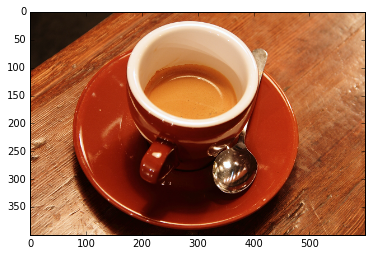

In [11]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)
print(og.min(), og.max())

We'll crop and resize the image to 224 x 224 pixels. I've provided a simple helper function which will do this for us:

In [12]:
# Note that in the lecture, I used a slightly different inception
# model, and this one requires us to subtract the mean from the input image.
# The preprocess function will also crop/resize the image to 299x299
img = inception.preprocess(og)
print(og.shape), print(img.shape)

(400, 600, 3)
(299, 299, 3)


(None, None)

In [13]:
# So this will now be a different range than what we had in the lecture:
print(img.min(), img.max())

-117.0 138.0


As we've seen from the last session, our images must be shaped as a 4-dimensional shape describing the number of images, height, width, and number of channels.  So our original 3-dimensional image of height, width, channels needs an additional dimension on the 0th axis.

In [14]:
img_4d = img[np.newaxis]
print(img_4d.shape)

(1, 299, 299, 3)


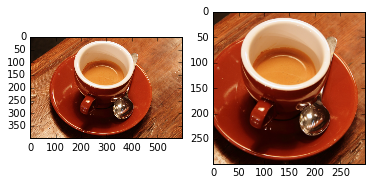

In [15]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(og)

# Note that unlike the lecture, we have to call the `inception.deprocess` function
# so that it adds back the mean!
axs[1].imshow(inception.deprocess(img))

In [16]:
res = np.squeeze(softmax.eval(feed_dict={x: img_4d}))

In [17]:
# Note that this network is slightly different than the one used in the lecture.
# Instead of just 1 output, there will be 16 outputs of 1008 probabilities.
# We only use the first 1000 probabilities (the extra ones are for negative/unseen labels)
res.shape

(16, 1008)

The result of the network is a 1000 element vector, with probabilities of each class.  Inside our `net` dictionary are the labels for every element.  We can sort these and use the labels of the 1000 classes to see what the top 5 predicted probabilities and labels are:

In [18]:
# Note that this is one way to aggregate the different probabilities.  We could also
# take the argmax.
res = np.mean(res, 0)
res = res / np.sum(res)

In [19]:
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99849206, (947, 'espresso')), (0.000631253, (859, 'cup')), (0.00050241494, (953, 'chocolate sauce')), (0.00019483207, (844, 'consomme')), (0.00013370356, (822, 'soup bowl'))]


<a name="visualizing-filters"></a>
## Visualizing Filters

Wow so it works!  But how!?  Well that's an ongoing research question.  There has been a lot of great developments in the last few years to help us understand what might be happening.  Let's try to first visualize the weights of the convolution filters, like we've done with our MNIST network before.

In [20]:
W = g.get_tensor_by_name('inception/conv2d0_w:0')
W_eval = W.eval()
print(W_eval.shape)

(7, 7, 3, 64)


With MNIST, our input number of filters was 1, since our input number of channels was also 1, as all of MNIST is grayscale.  But in this case, our input number of channels is 3, and so the input number of convolution filters is also 3.  We can try to see every single individual filter using the library tool I've provided:

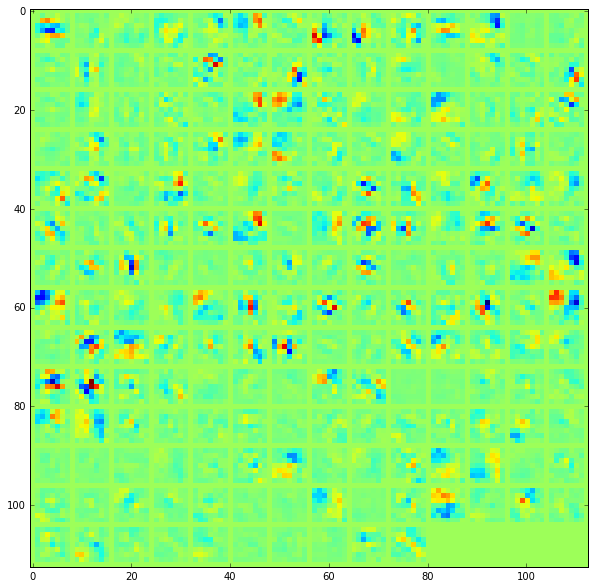

In [21]:
from libs import utils
W_montage = utils.montage_filters(W_eval)
plt.figure(figsize=(10,10))
plt.imshow(W_montage, interpolation='nearest')

Or, we can also try to look at them as RGB filters, showing the influence of each color channel, for each neuron or output filter.

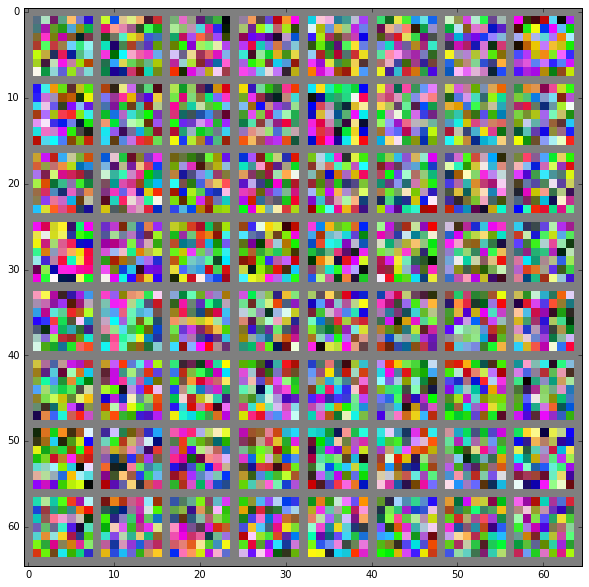

In [22]:
Ws = [utils.montage_filters(W_eval[:, :, [i], :]) for i in range(3)]
Ws = np.rollaxis(np.array(Ws), 0, 3)
plt.figure(figsize=(10,10))
plt.imshow(Ws, interpolation='nearest')

In order to better see what these are doing, let's normalize the filters range:

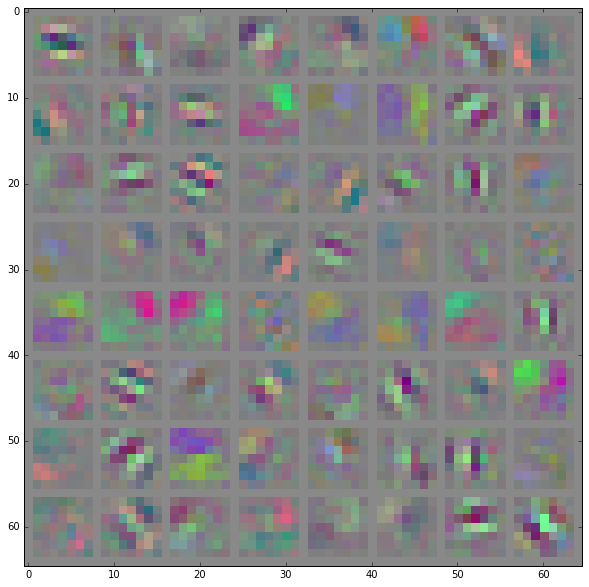

In [23]:
np.min(Ws), np.max(Ws)
Ws = (Ws / np.max(np.abs(Ws)) * 128 + 128).astype(np.uint8)
plt.figure(figsize=(10,10))
plt.imshow(Ws, interpolation='nearest')

Like with our MNIST example, we can probably guess what some of these are doing.  They are responding to edges, corners, and center-surround or some kind of contrast of two things, like red, green, blue yellow, which interestingly is also what neuroscience of vision tells us about how the human vision identifies color, which is through opponency of red/green and blue/yellow.  To get a better sense, we can try to look at the output of the convolution:

In [24]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')

Let's look at the shape:

In [25]:
layer_shape = tf.shape(feature).eval(feed_dict={x:img_4d})
print(layer_shape)

[  1 150 150  64]


So our original image which was 1 x 224 x 224 x 3 color channels, now has 64 new channels of information.  The image's height and width are also halved, because of the stride of 2 in the convolution.  We've just seen what each of the convolution filters look like.  Let's try to see how they filter the image now by looking at the resulting convolution.

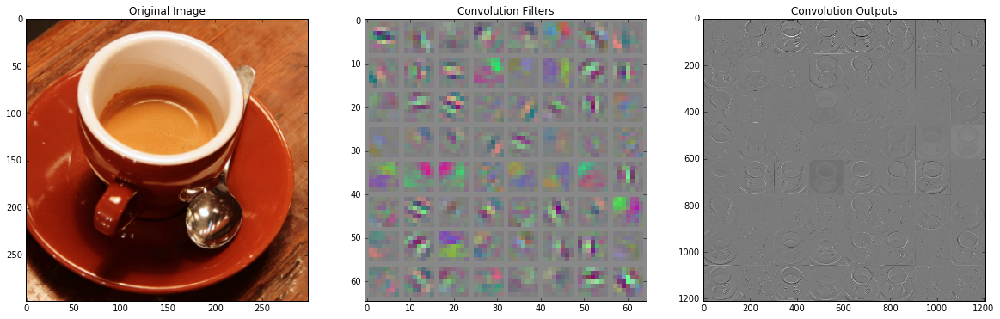

In [26]:
f = feature.eval(feed_dict={x: img_4d})
montage = utils.montage_filters(np.rollaxis(np.expand_dims(f[0], 3), 3, 2))
fig, axs = plt.subplots(1, 3, figsize=(20, 10))
axs[0].imshow(inception.deprocess(img))
axs[0].set_title('Original Image')
axs[1].imshow(Ws, interpolation='nearest')
axs[1].set_title('Convolution Filters')
axs[2].imshow(montage, cmap='gray')
axs[2].set_title('Convolution Outputs')

It's a little hard to see what's happening here but let's try.  The third filter for instance seems to be a lot like the gabor filter we created in the first session.  It respond to horizontal edges, since it has a bright component at the top, and a dark component on the bottom.  Looking at the output of the convolution, we can see that the horizontal edges really pop out.

<a name="visualizing-the-gradient"></a>
## Visualizing the Gradient

So this is a pretty useful technique for the first convolution layer.  But when we get to the next layer, all of sudden we have 64 different channels of information being fed to more convolution filters of some very high dimensions.  It's very hard to conceptualize that many dimensions, let alone also try and figure out what it could be doing with all the possible combinations it has with other neurons in other layers.

If we want to understand what the deeper layers are really doing, we're going to have to start to use backprop to show us the gradients of a particular neuron with respect to our input image.  Let's visualize the network's gradient activation when backpropagated to the original input image.  This is effectively telling us which pixels are responding to the predicted class or given neuron.

We use a forward pass up to the layer that we are interested in, and then a backprop to help us understand what pixels in particular contributed to the final activation of that layer.  We will need to create an operation which will find the max neuron of all activations in a layer, and then calculate the gradient of that objective with respect to the input image.

In [27]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')
gradient = tf.gradients(tf.reduce_max(feature, 3), x)

When we run this network now, we will specify the gradient operation we've created, instead of the softmax layer of the network.  This will run a forward prop up to the layer we asked to find the gradient with, and then run a back prop all the way to the input image.

In [28]:
res = sess.run(gradient, feed_dict={x: img_4d})[0]

Let's visualize the original image and the output of the backpropagated gradient:

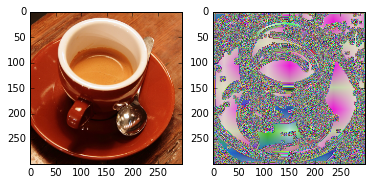

In [29]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(res[0])

Well that looks like a complete mess!  What we can do is normalize the activations in a way that let's us see it more in terms of the normal range of color values.

In [30]:
def normalize(img, s=0.1):
    '''Normalize the image range for visualization'''
    z = img / np.std(img)
    return np.uint8(np.clip(
        (z - z.mean()) / max(z.std(), 1e-4) * s + 0.5,
        0, 1) * 255)

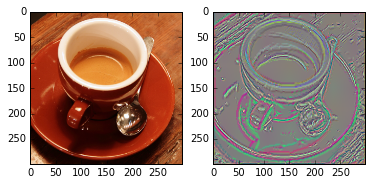

In [31]:
r = normalize(res)
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(r[0])

Much better!  This sort of makes sense!  There are some strong edges and we can really see what colors are changing along those edges.

We can try within individual layers as well, pulling out individual neurons to see what each of them are responding to.  Let's first create a few functions which will help us visualize a single neuron in a layer, and every neuron of a layer:

In [32]:
def compute_gradient(input_placeholder, img, layer_name, neuron_i):
    feature = g.get_tensor_by_name(layer_name)
    gradient = tf.gradients(tf.reduce_mean(feature[:, :, :, neuron_i]), x)
    res = sess.run(gradient, feed_dict={input_placeholder: img})[0]
    return res

def compute_gradients(input_placeholder, img, layer_name):
    feature = g.get_tensor_by_name(layer_name)
    layer_shape = tf.shape(feature).eval(feed_dict={input_placeholder: img})
    gradients = []
    for neuron_i in range(layer_shape[-1]):
        gradients.append(compute_gradient(input_placeholder, img, layer_name, neuron_i))
    return gradients

Now we can pass in a layer name, and see the gradient of every neuron in that layer with respect to the input image as a montage.  Let's try the second convolutional layer.  This can take awhile depending on your computer:

In [33]:
gradients = compute_gradients(x, img_4d, 'inception/conv2d1_pre_relu:0')
gradients_norm = [normalize(gradient_i[0]) for gradient_i in gradients]
montage = utils.montage(np.array(gradients_norm))

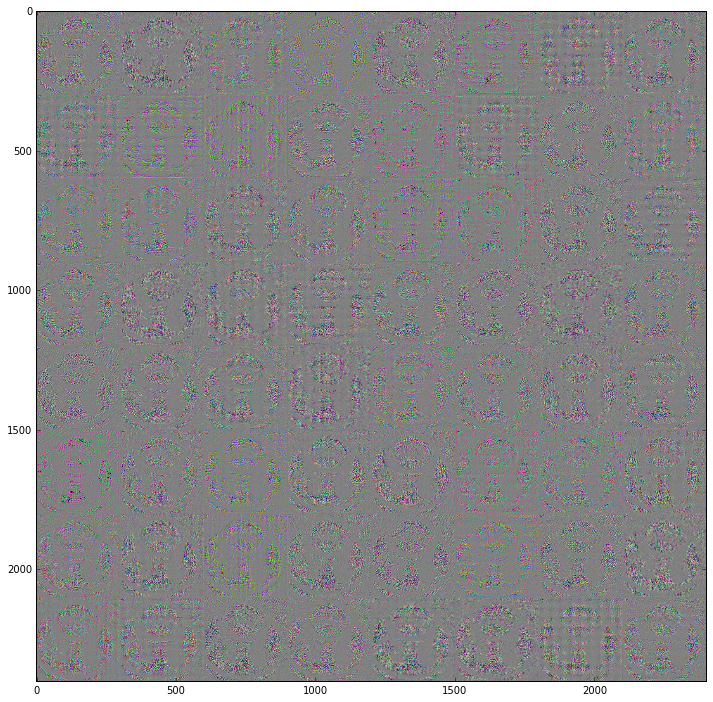

In [34]:
plt.figure(figsize=(12, 12))
plt.imshow(montage)

So it's clear that each neuron is responding to some type of feature.  It looks like a lot of them are interested in the texture of the cup, and seem to respond in different ways across the image.  Some seem to be more interested in the shape of the cup, responding pretty strongly to the circular opening, while others seem to catch the liquid in the cup more.  There even seems to be one that just responds to the spoon, and another which responds to only the plate.

Let's try to get a sense of how the activations in each layer progress. We can get every max pooling layer like so:

In [35]:
features = [name for name in names if 'maxpool' in name.split()[-1]]
print(features)

['inception/maxpool0', 'inception/maxpool1', 'inception/maxpool4', 'inception/maxpool10']


So I didn't mention what max pooling is.  But it 's a simple operation.  You can think of it like a convolution, except instead of using a learned kernel, it will just find the maximum value in the window, for performing "max pooling", or find the average value, for performing "average pooling".

We'll now loop over every feature and create an operation that first will find the maximally activated neuron.  It will then find the sum of all activations across every pixel and input channel of this neuron, and then calculate its gradient with respect to the input image.

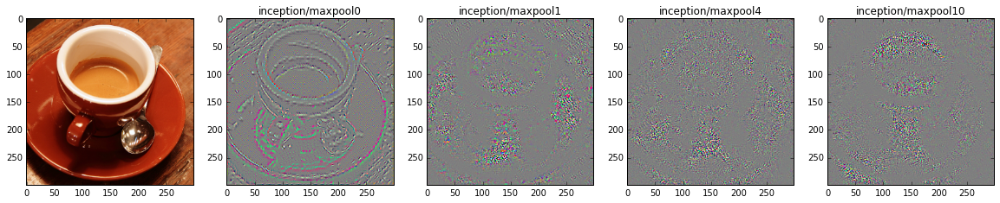

In [36]:
n_plots = len(features) + 1
fig, axs = plt.subplots(1, n_plots, figsize=(20, 5))
base = img_4d
axs[0].imshow(inception.deprocess(img))
for feature_i, featurename in enumerate(features):
    feature = g.get_tensor_by_name(featurename + ':0')
    neuron = tf.reduce_max(feature, len(feature.get_shape())-1)
    gradient = tf.gradients(tf.reduce_sum(neuron), x)
    this_res = sess.run(gradient[0], feed_dict={x: base})[0]
    axs[feature_i+1].imshow(normalize(this_res))
    axs[feature_i+1].set_title(featurename)

To really understand what's happening in these later layers, we're going to have to experiment with some other visualization techniques.

<a name="deep-dreaming"></a>
# Deep Dreaming

Sometime in May of 2015, A researcher at Google, Alexander Mordvintsev, took a deep network meant to recognize objects in an image, and instead used it to *generate new objects in an image.  The internet quickly exploded after seeing one of the images it produced.  Soon after, Google posted a blog entry on how to perform the technique they re-dubbed "Inceptionism", <TODO: cut to blog and scroll> and tons of interesting outputs were soon created.  Somehow the name Deep Dreaming caught on, and tons of new creative applications came out, from twitter bots (DeepForger), to streaming television (twitch.tv), to apps, it was soon everywhere.

What Deep Dreaming is doing is taking the backpropagated gradient activations and simply adding it back to the image, running the same process again and again in a loop.  I think "dreaming" is a great description of what's going on.  We're really pushing the network in a direction, and seeing what happens when left to its devices.  What it is effectively doing is amplifying whatever our objective is, but we get to see how that objective is optimized in the input space rather than deep in the network in some arbitrarily high dimensional space that no one can understand.

There are many tricks one can add to this idea, such as blurring, adding constraints on the total activations, decaying the gradient, infinitely zooming into the image by cropping and scaling, adding jitter by randomly moving the image around, or plenty of other ideas waiting to be explored.

<a name="simplest-approach"></a>
## Simplest Approach

Let's try the simplest approach for deep dream using a few of these layers.  We're going to try the first max pooling layer to begin with.  We'll specify our objective which is to follow the gradient of the mean of the selected layers's activation.  What we should see is that same objective being amplified so that we can start to understand in terms of the input image what the mean activation of that layer tends to like, or respond to.  We'll also produce a gif of every few frames.  For the remainder of this section, we'll need to rescale our 0-255 range image to 0-1 as it will speed up things:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

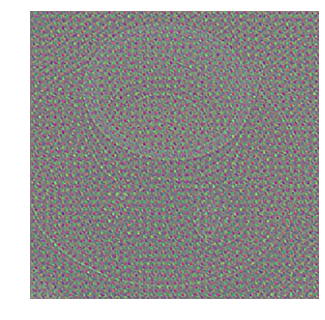

In [37]:
# Rescale to 0-1 range
img_4d = img_4d / np.max(img_4d)

# Get the max pool layer
layer = g.get_tensor_by_name('inception/maxpool0:0')

# Find the gradient of this layer's mean activation with respect to the input image
gradient = tf.gradients(tf.reduce_mean(layer), x)

# Copy the input image as we'll add the gradient to it in a loop
img_copy = img_4d.copy()

# We'll run it for 50 iterations
n_iterations = 50

# Think of this as our learning rate.  This is how much of the gradient we'll add to the input image
step = 1.0

# Every 10 iterations, we'll add an image to a GIF
gif_step = 10

# Storage for our GIF
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')

    # This will calculate the gradient of the layer we chose with respect to the input image.
    this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]

    # Let's normalize it by the maximum activation
    this_res /= (np.max(np.abs(this_res)) + 1e-8)

    # Then add it to the input image
    img_copy += this_res * step

    # And add to our gif
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))

# Build the gif
gif.build_gif(imgs, saveto='1-simplest-mean-layer.gif')

In [38]:
ipyd.Image(url='1-simplest-mean-layer.gif', height=200, width=200)

What we can see is pretty quickly, the activations tends to pick up the fine detailed edges of the cup, plate, and spoon.  Their structure is very local, meaning they are really describing information at a very small scale.

We could also specify the maximal neuron's mean activation, instead of the mean of the entire layer:

In [39]:
# Find the maximal neuron in a layer
neuron = tf.reduce_max(layer, len(layer.get_shape())-1)
# Then find the mean over this neuron
gradient = tf.gradients(tf.reduce_mean(neuron), x)

The rest is exactly the same as before:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

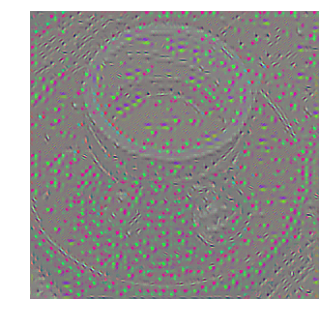

In [40]:
img_copy = img_4d.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='1-simplest-max-neuron.gif')

In [41]:
ipyd.Image(url='1-simplest-max-neuron.gif', height=200, width=200)

What we should see here is how the maximal neuron in a layer's activation is slowly maximized through gradient ascent. So over time, we're increasing the overall activation of the neuron we asked for.

Let's try doing this for each of our max pool layers, in increasing depth, and let it run a little longer.  This will take a long time depending on your machine!

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

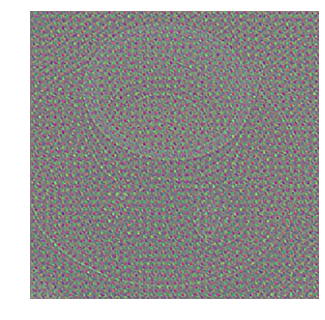

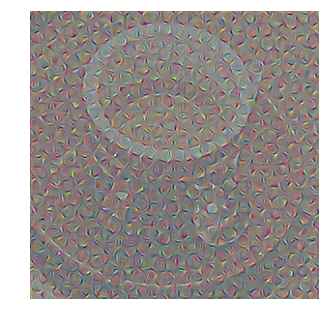

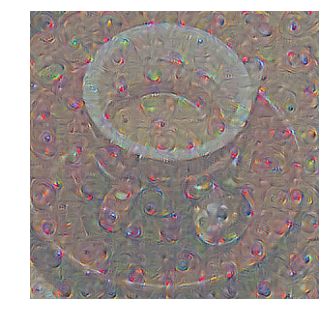

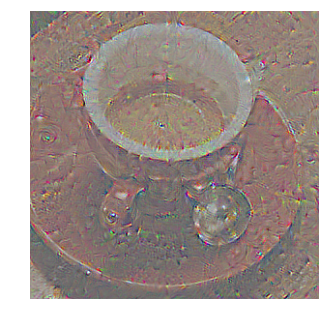

In [42]:
# For each max pooling feature, we'll produce a GIF
for feature_i in features:
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_4d.copy()
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]
        this_res /= (np.max(np.abs(this_res)) + 1e-8)
        img_copy += this_res * step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(
        imgs, saveto='1-simplest-' + feature_i.split('/')[-1] + '.gif')

When we look at the outputs of these, we should see the representations in corresponding layers being amplified on the original input image.  As we get to later layers, it really starts to appear to hallucinate, and the patterns start to get more complex.  That's not all though.  The patterns also seem to grow larger.  What that means is that at later layers, the representations span a larger part of the image.  In neuroscience, we might say that this has a larger receptive field, since it is receptive to the content in a wider visual field.

Let's try the same thing except now we'll feed in noise instead of an image:

In [43]:
# Create some noise, centered at gray
img_noise = inception.preprocess(
    (np.random.randint(100, 150, size=(224, 224, 3))))[np.newaxis]
print(img_noise.min(), img_noise.max())

-17.0 31.9579


And the rest is the same:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

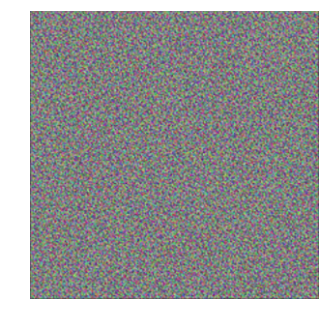

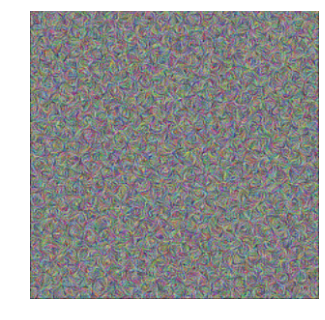

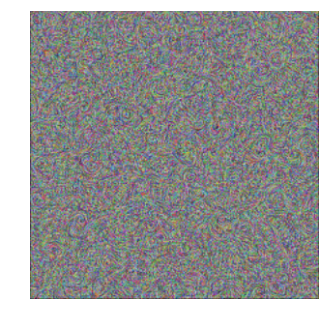

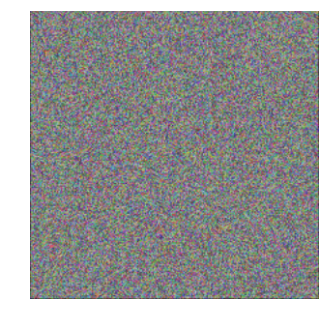

In [44]:
for feature_i in features:
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_noise.copy()
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]
        this_res /= (np.max(np.abs(this_res)) + 1e-8)
        img_copy += this_res * step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(
        imgs, saveto='1-simplest-noise-' + feature_i.split('/')[-1] + '.gif')

What we should see is that patterns start to emerge, and with higher and higher complexity as we get deeper into the network!

Think back to when we were trying to hand engineer a convolution kernel in the first session.  This should seem pretty amazing to you now.  We've just seen that a network trained in the same way that we trained on MNIST in the last session, just with more layers, and a lot more data, can represent so much detail, and such complex patterns.

<a name="specifying-the-objective"></a>
## Specifying the Objective

Let's summarize a bit what we've done.  What we're doing is let the input image's activation at some later layer or neuron determine what we want to optimize.  We feed an image into the network and see what its activations are for a given neuron or entire layer are by backproping the gradient of that activation back to the input image.  Remember, the gradient is just telling us how things change.  So by following the direction of the gradient, we're going up the gradient, or ascending, and maximizing the selected layer or neuron's activation by changing our input image.

By going up the gradient, we're saying, let's maximize this neuron or layer's activation.  That's different to what we we're doing with gradient descent of a cost function.  Because that was a cost function, we wanted to minimize it, and we were following the negative direction of our gradient.  So the only difference now is we are following the positive direction of our gradient, and performing gradient ascent.

We can also explore specifying a particular gradient activation that we want to maximize.  So rather than simply maximizing its activation, we'll specify what we want the activation to look like, and follow the gradient to get us there.  For instance, let's say we want to only have a particular neuron active, and nothing else.  We can do that by creating an array of 0s the shape of one of our layers, and then filling in 1s for the output of that neuron:

In [45]:
# Let's pick one of the later layers
layer = g.get_tensor_by_name('inception/mixed5b_pool_reduce_pre_relu:0')

# And find its shape
layer_shape = tf.shape(layer).eval(feed_dict={x:img_4d})

# We can find out how many neurons it has by feeding it an image and
# calculating the shape.  The number of output channels is the last dimension.
n_els = tf.shape(layer).eval(feed_dict={x:img_4d})[-1]

# Let's pick a random output channel
neuron_i = np.random.randint(n_els)

# And we'll create an activation of this layer which is entirely 0
layer_vec = np.zeros(layer_shape)

# Except for the randomly chosen neuron which will be full of 1s
layer_vec[..., neuron_i] = 1

# We'll go back to finding the maximal neuron in a layer
neuron = tf.reduce_max(layer, len(layer.get_shape())-1)

# And finding the mean over this neuron
gradient = tf.gradients(tf.reduce_mean(neuron), x)

We then feed this into our `feed_dict` parameter and do the same thing as before, ascending the gradient.  We'll try this for a few different neurons to see what they look like.  Again, this will take a long time depending on your computer!

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 

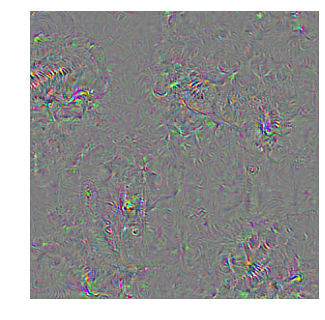

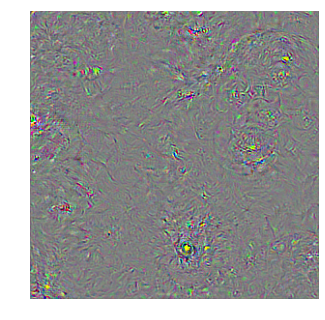

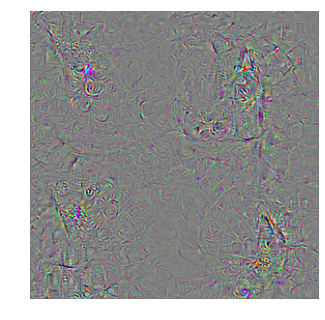

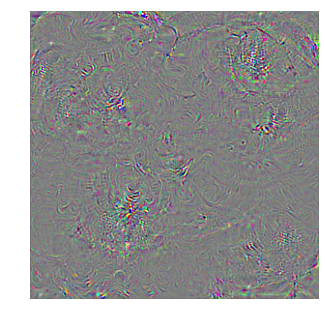

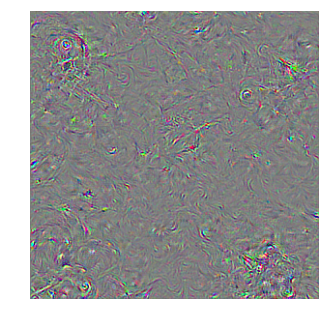

In [46]:
n_iterations = 30
for i in range(5):
    neuron_i = np.random.randint(n_els)
    layer_vec = np.zeros(layer_shape)
    layer_vec[..., neuron_i] = 1
    img_copy = img_noise.copy() / 255.0
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={
            x: img_copy,
            layer: layer_vec})[0]
        this_res /= (np.max(np.abs(this_res)) + 1e-8)
        img_copy += this_res * step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(imgs, saveto='2-objective-' + str(neuron_i) + '.gif')

So there is definitely something very interesting happening in each of these neurons.  Even though each image starts off exactly the same, from the same noise image, they each end up in a very different place.  What we're seeing is how each neuron we've chosen seems to be encoding something complex.  They even somehow trigger our perception in a way that says, "Oh, that sort of looks like... maybe a house, or a dog, or a fish, or person...something"

Since our network is trained on objects, we know what each neuron of the last layer should represent.  So we can actually try this with the very last layer, the final layer which we know should represent 1 of 1000 possible objects.  Let's see how to do this.  Let's first find a good neuron:

In [47]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

In [48]:
# let's try a school bus.
neuron_i = 962
print(net['labels'][neuron_i])

(962, 'school bus')


In [49]:
# We'll pick the very last layer
layer = g.get_tensor_by_name(names[-1] + ':0')

# Then find the max activation of this layer
gradient = tf.gradients(tf.reduce_max(layer), x)

# We'll find its shape and create the activation we want to maximize w/ gradient ascent
layer_shape = tf.shape(layer).eval(feed_dict={x: img_noise})
layer_vec = np.zeros(layer_shape)
layer_vec[..., neuron_i] = 1

And then train just like before:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 

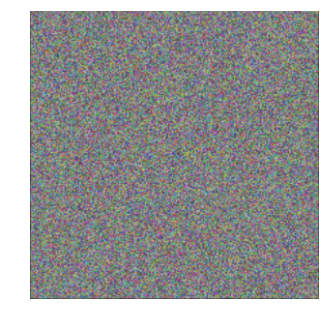

In [50]:
n_iterations = 100
gif_step = 10

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='2-object-' + str(neuron_i) + '.gif')

So what we should see is the noise image become more like patterns that might appear on a school bus.

<a name="decaying-the-gradient"></a>
## Decaying the Gradient

There is a lot we can explore with this process to get a clearer picture.  Some of the more interesting visualizations come about through regularization techniques such as smoothing the activations every so often, or clipping the gradients to a certain range.  We'll see how all of these together can help us get a much cleaner image.  We'll start with decay.  This will slowly reduce the range of values:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 

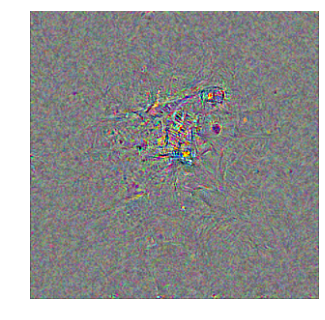

In [51]:
decay = 0.95

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='3-decay-' + str(neuron_i) + '.gif')

<a name="blurring-the-gradient"></a>
## Blurring the Gradient

Let's now try and see how blurring with a gaussian changes the visualization.

In [52]:
# Let's get a gaussian filter
from scipy.ndimage.filters import gaussian_filter

# Which we'll smooth with a standard deviation of 0.5
sigma = 1.0

# And we'll smooth it every 4 iterations
blur_step = 5

Now during our training, we'll smooth every `blur_step` iterations with the given `sigma`.

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 

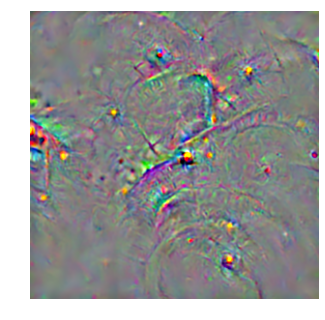

In [53]:
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='4-gaussian-' + str(neuron_i) + '.gif')

In [54]:
ipyd.Image(url='4-gaussian-962.gif', height=300, width=300)

Now we're really starting to get closer to something that resembles a school bus, or maybe a school bus double rainbow.

<a name="clipping-the-gradient"></a>
## Clipping the Gradient

Let's now see what happens if we clip the gradient's activations:

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 

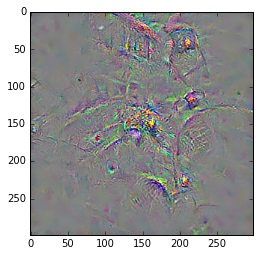

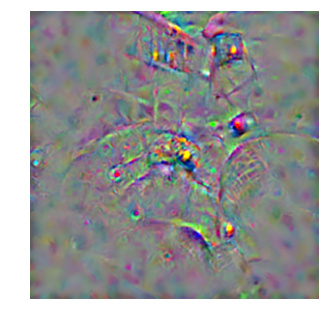

In [55]:
pth = 5
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)

    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy*mask

    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))

plt.imshow(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='5-clip-' + str(neuron_i) + '.gif')

In [56]:
ipyd.Image(url='5-clip-962.gif', height=300, width=300)

<a name="infinite-zoom--fractal"></a>
## Infinite Zoom / Fractal

Some of the first visualizations to come out would infinitely zoom into the image, creating a fractal image of the deep dream.  We can do this by cropping the image with a 1 pixel border, and then resizing that image back to the original size.

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

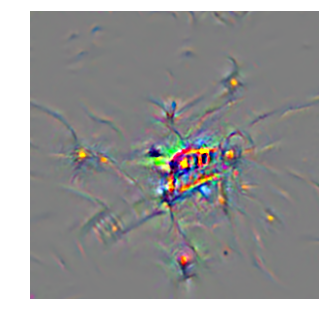

In [57]:
from skimage.transform import resize
img_copy = img_noise.copy()
crop = 1
n_iterations = 1000
imgs = []
n_img, height, width, ch = img_copy.shape
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay

    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)

    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy * mask

    # Crop a 1 pixel border from height and width
    img_copy = img_copy[:, crop:-crop, crop:-crop, :]

    # Resize (Note: in the lecture, we used scipy's resize which
    # could not resize images outside of 0-1 range, and so we had
    # to store the image ranges.  This is a much simpler resize
    # method that allows us to `preserve_range`.)
    img_copy = resize(img_copy[0], (height, width), order=3,
                 clip=False, preserve_range=True
                 )[np.newaxis].astype(np.float32)

    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))

gif.build_gif(imgs, saveto='6-fractal.gif')

In [58]:
ipyd.Image(url='6-fractal.gif', height=300, width=300)

<a name="style-net"></a>
# Style Net

Leon Gatys and his co-authors demonstrated a pretty epic extension to deep dream which showed that neural networks trained on objects like the one we've been using actually represent both content and style, and that these can be independently manipulated, for instance taking the content from one image, and the style from another.  They showed how you could artistically stylize the same image with a wide range of different painterly aesthetics.  Let's take a look at how we can do that.  We're going to use the same network that they've used in their paper, VGG.  This network is a lot less complicated than the Inception network, but at the expense of having a lot more parameters.

<a name="vgg-network"></a>
## VGG Network

In the resources section, you can find the library for loading this network, just like you've done w/ the Inception network.  Let's reset the graph:

In [3]:
import tensorflow as tf
from libs import utils

In [5]:
from tensorflow.python.framework.ops import reset_default_graph
sess.close()
reset_default_graph()

And now we'll load up the new network, except unlike before, we're going to explicitly create a graph, and tell the session to use this graph.  If we didn't do this, tensorflow would just use the default graph that is always there.  But since we're going to be making a few graphs, we'll need to do it like this.

In [6]:
from libs import vgg16
net = vgg16.get_vgg_model()

Note: We will explicitly define a context manager here to handle the graph and place the graph in CPU memory instead of GPU memory, as this is a very large network!

In [7]:
g = tf.Graph()
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    tf.import_graph_def(net['graph_def'], name='vgg')
    names = [op.name for op in g.get_operations()]

Let's take a look at the network:

In [8]:
nb_utils.show_graph(net['graph_def'])

In [9]:
print(names)

['vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv3_2', 'vgg/conv3_3/filter', 'vgg/conv3_3/Conv2D', 'vgg/conv3_3/biases', 'vgg/conv3_3/BiasAdd', 'vgg/conv3_3/conv3_

So unlike inception, which has many parallel streams and concatenation operations, this network is much like the network we've created in the last session.  A pretty basic deep convolutional network with a single stream of many convolutions, followed by adding biases, and using relu non-linearities.

<TODO: produce tesnorboard visual>

Let's grab a placeholder for the input and output of the network:

In [10]:
x = g.get_tensor_by_name(names[0] + ':0')
softmax = g.get_tensor_by_name(names[-2] + ':0')

We'll grab an image preprocess, add a new dimension to make the image 4-D, then predict the label of this image just like we did with the Inception network:

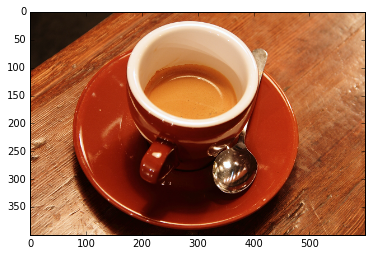

In [11]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)

In [12]:
img = vgg16.preprocess(og)

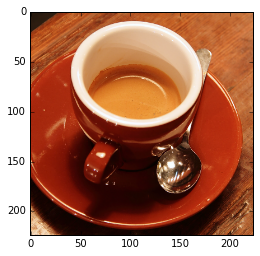

In [13]:
plt.imshow(vgg16.deprocess(img))

In [14]:
img_4d = img[np.newaxis]

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    res = softmax.eval(feed_dict={x: img_4d})[0]
    print([(res[idx], net['labels'][idx])
           for idx in res.argsort()[-5:][::-1]])

[(0.99072862, (967, 'n07920052 espresso')), (0.0038241001, (968, 'n07930864 cup')), (0.0016883078, (868, 'n04476259 tray')), (0.0012987712, (960, 'n07836838 chocolate sauce, chocolate syrup')), (0.0011314416, (925, 'n07584110 consomme'))]


<a name="dropout"></a>
## Dropout

If I run this again, I get a different result:

In [15]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    res = softmax.eval(feed_dict={x: img_4d})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.88728428, (967, 'n07920052 espresso')), (0.077477559, (968, 'n07930864 cup')), (0.018839369, (960, 'n07836838 chocolate sauce, chocolate syrup')), (0.006374768, (925, 'n07584110 consomme')), (0.0063688005, (504, 'n03063599 coffee mug'))]


That's because this network is using something called dropout.  Basically, dropout will randomly drop connections.  This is useful because it allows multiple paths of explanations for a network.  Consider how this might be manifested in an image recognition network.  Perhaps part of the object is occluded.  We would still want the network to be able to describe the object.  That's a very useful thing to do during training to do what's called regularization.  Basically regularization is a fancy term for make sure the activations are within a certain range which I won't get into there.  It turns out there are other very good ways of performing regularization including dropping entire layers instead of indvidual neurons; or performing what's called batch normalization, which I also won't get into here.

To use the VGG network without dropout, we'll have to set the values of the dropout "keep" probability to be 1, meaning don't drop any connections:

In [16]:
[name_i for name_i in names if 'dropout' in name_i]

['vgg/dropout/Shape',
 'vgg/dropout/random_uniform/min',
 'vgg/dropout/random_uniform/range',
 'vgg/dropout/random_uniform/RandomUniform',
 'vgg/dropout/random_uniform/mul',
 'vgg/dropout/random_uniform',
 'vgg/dropout/add/x',
 'vgg/dropout/add',
 'vgg/dropout/Floor',
 'vgg/dropout/mul/y',
 'vgg/dropout/mul',
 'vgg/dropout/mul_1',
 'vgg/dropout_1/Shape',
 'vgg/dropout_1/random_uniform/min',
 'vgg/dropout_1/random_uniform/range',
 'vgg/dropout_1/random_uniform/RandomUniform',
 'vgg/dropout_1/random_uniform/mul',
 'vgg/dropout_1/random_uniform',
 'vgg/dropout_1/add/x',
 'vgg/dropout_1/add',
 'vgg/dropout_1/Floor',
 'vgg/dropout_1/mul/y',
 'vgg/dropout_1/mul',
 'vgg/dropout_1/mul_1']

Looking at the network, it looks like there are 2 dropout layers.  Let's set these values to 1 by telling the `feed_dict` parameter.

In [17]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    res = softmax.eval(feed_dict={
        x: img_4d,
        'vgg/dropout_1/random_uniform:0': [[1.0]],
        'vgg/dropout/random_uniform:0': [[1.0]]})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99999619, (967, 'n07920052 espresso')), (3.8687845e-06, (968, 'n07930864 cup')), (5.4153543e-10, (504, 'n03063599 coffee mug')), (3.8140457e-10, (960, 'n07836838 chocolate sauce, chocolate syrup')), (3.2201272e-10, (925, 'n07584110 consomme'))]


Let's try again to be sure:

In [18]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    res = softmax.eval(feed_dict={
        x: img_4d,
        'vgg/dropout_1/random_uniform:0': [[1.0]],
        'vgg/dropout/random_uniform:0': [[1.0]]})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99999619, (967, 'n07920052 espresso')), (3.8687845e-06, (968, 'n07930864 cup')), (5.4153543e-10, (504, 'n03063599 coffee mug')), (3.8140457e-10, (960, 'n07836838 chocolate sauce, chocolate syrup')), (3.2201272e-10, (925, 'n07584110 consomme'))]


Great so we get the exact same probability and it works just like the Inception network!

<a name="defining-the-content-features"></a>
## Defining the Content Features

For the "content" of the image, we're going to need to know what's happening in the image at the broadest spatial scale.  Remember before when we talked about deeper layers having a wider receptive field?  We're going to use that knowledge to say that the later layers are better at representing the overall content of the image.  Let's try using the 4th layer's convolution for the determining the content:

In [19]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    content_layer = 'vgg/conv4_2/conv4_2:0'
    content_features = g.get_tensor_by_name(content_layer).eval(
            session=sess,
            feed_dict={x: img_4d,
                'vgg/dropout_1/random_uniform:0': [[1.0]],
                'vgg/dropout/random_uniform:0': [[1.0]]
            })
print(content_features.shape)

(1, 28, 28, 512)


<a name="defining-the-style-features"></a>
## Defining the Style Features

Great.  We now have a tensor describing the content of our original image.  We're going to stylize it now using another image.  We'll need to grab another image.  I'm going to use Hieronymous Boschs's famous still life painting of sunflowers.

In [20]:
filepath = utils.download('https://upload.wikimedia.org/wikipedia/commons/thumb/a/ae/El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg/640px-El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg')

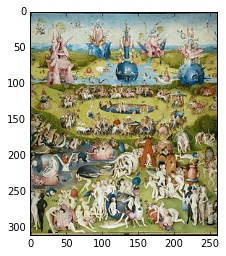

In [21]:
# Note: Unlike in the lecture, I've cropped the image a bit as the borders took over too much...
style_og = plt.imread(filepath)[15:-15, 190:-190, :]
plt.imshow(style_og)

We'll need to preprocess it just like we've done with the image of the espresso:

In [22]:
style_img = vgg16.preprocess(style_og)
style_img_4d = style_img[np.newaxis]

And for fun let's see what VGG thinks of it:

In [23]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    res = softmax.eval(
        feed_dict={
            x: style_img_4d,
            'vgg/dropout_1/random_uniform:0': [[1.0]],
            'vgg/dropout/random_uniform:0': [[1.0]]})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99336135, (611, 'n03598930 jigsaw puzzle')), (0.0052440548, (868, 'n04476259 tray')), (0.0011667105, (591, 'n03485794 handkerchief, hankie, hanky, hankey')), (0.00011143424, (865, 'n04462240 toyshop')), (4.7309215e-05, (917, 'n06596364 comic book'))]


So it's not great.  It looks like it thinks it's a jigsaw puzzle. What we're going to do is find features of this image at different layers in the network.

In [24]:
style_layers = ['vgg/conv1_1/conv1_1:0',
                'vgg/conv2_1/conv2_1:0',
                'vgg/conv3_1/conv3_1:0',
                'vgg/conv4_1/conv4_1:0',
                'vgg/conv5_1/conv5_1:0']
style_activations = []

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    for style_i in style_layers:
        style_activation_i = g.get_tensor_by_name(style_i).eval(
            feed_dict={
                x: style_img_4d,
                'vgg/dropout_1/random_uniform:0': [[1.0]],
                'vgg/dropout/random_uniform:0': [[1.0]]})
        style_activations.append(style_activation_i)

Instead of using the raw activations of these layers, what the authors of the StyleNet paper suggest is to use the Gram activation of the layers instead, which mathematically is expressed as the matrix transpose multiplied by itself.  The intuition behind this process is that it measures the similarity between every feature of a matrix.  Or put another way, it is saying how often certain features appear together.

This would seem useful for "style", as what we're trying to do is see what's similar across the image.  To get every feature, we're going to have to reshape our N x H x W x C matrix to have every pixel belonging to each feature in a single column.  This way, when we take the transpose and multiply it against itself, we're measuring the shared direction of every feature with every other feature.  Intuitively, this would be useful as a measure of style, since we're measuring whats in common across all pixels and features.

In [25]:
style_features = []
for style_activation_i in style_activations:
    s_i = np.reshape(style_activation_i, [-1, style_activation_i.shape[-1]])
    gram_matrix = np.matmul(s_i.T, s_i) / s_i.size
    style_features.append(gram_matrix.astype(np.float32))

<a name="remapping-the-input"></a>
## Remapping the Input

So now we have a collection of "features", which are basically the activations of our sunflower image at different layers.  We're now going to try and make our coffee image have the same style as this image by trying to enforce these features on the image.  Let's take a look at how we can do that.

We're going to need to create a new graph which replaces the input of the original VGG network with a variable which can be optimized.  So instead of having a placeholder as input to the network, we're going to tell tensorflow that we want this to be a `tf.Variable`.  That's because we're going to try to optimize what this is, based on the objectives which we'll soon create.

In [26]:
reset_default_graph()
g = tf.Graph()

And now we'll load up the VGG network again, except unlike before, we're going to map the input of this network to a new variable randomly initialized to our content image.  Alternatively, we could initialize this image noise to see a different result.

In [27]:
net = vgg16.get_vgg_model()
# net_input = tf.get_variable(
#    name='input',
#    shape=(1, 224, 224, 3),
#    dtype=tf.float32,
#    initializer=tf.random_normal_initializer(
#        mean=np.mean(img), stddev=np.std(img)))
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    net_input = tf.Variable(img_4d)
    tf.import_graph_def(
        net['graph_def'],
        name='vgg',
        input_map={'images:0': net_input})

Let's take a look at the graph now:

In [28]:
names = [op.name for op in g.get_operations()]
print(names)

['Variable/initial_value', 'Variable', 'Variable/Assign', 'Variable/read', 'vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv3_2', 'vgg/conv3_3/filter', 'vgg/conv3_3

So notice now the first layers of the network have everything prefixed by input, our new variable which we've just created.  This will initialize a variable with the content image upon initialization.  And then as we run whatever our optimizer ends up being, it will slowly become the a stylized image.

<a name="defining-the-content-loss"></a>
## Defining the Content Loss

We now need to define a loss function which tries to optimize the distance between the net's output at our content layer, and the content features which we have built from the coffee image:

In [29]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    content_loss = tf.nn.l2_loss((g.get_tensor_by_name(content_layer) -
                                 content_features) /
                                 content_features.size)

<a name="defining-the-style-loss"></a>
## Defining the Style Loss

For our style loss, we'll compute the gram matrix of the current network output, and then measure the l2 loss with our precomputed style image's gram matrix.  So most of this is the same as when we compute the gram matrix for the style image, except now, we're doing this in tensorflow's computational graph, so that we can later connect these operations to an optimizer. Refer to the lecture for a more in depth explanation of this.

In [30]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    style_loss = np.float32(0.0)
    for style_layer_i, style_gram_i in zip(style_layers, style_features):
        layer_i = g.get_tensor_by_name(style_layer_i)
        layer_shape = layer_i.get_shape().as_list()
        layer_size = layer_shape[1] * layer_shape[2] * layer_shape[3]
        layer_flat = tf.reshape(layer_i, [-1, layer_shape[3]])
        gram_matrix = tf.matmul(tf.transpose(layer_flat), layer_flat) / layer_size
        style_loss = tf.add(style_loss, tf.nn.l2_loss((gram_matrix - style_gram_i) / np.float32(style_gram_i.size)))

<a name="defining-the-total-variation-loss"></a>
## Defining the Total Variation Loss

Lastly, we'll create a third loss value which will simply measure the difference between neighboring pixels.  By including this as a loss, we're saying that we want neighboring pixels to be similar.

In [31]:
def total_variation_loss(x):
    h, w = x.get_shape().as_list()[1], x.get_shape().as_list()[1]
    dx = tf.square(x[:, :h-1, :w-1, :] - x[:, :h-1, 1:, :])
    dy = tf.square(x[:, :h-1, :w-1, :] - x[:, 1:, :w-1, :])
    return tf.reduce_sum(tf.pow(dx + dy, 1.25))

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    tv_loss = total_variation_loss(net_input)

<a name="training"></a>
## Training

With both content and style losses, we can combine the two, optimizing our loss function, and creating a stylized coffee cup.

In [32]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    loss = 0.1 * content_loss + 5.0 * style_loss + 0.01 * tv_loss
    optimizer = tf.train.AdamOptimizer(0.01).minimize(loss)

0: 47.247391, (-0.010000 - 1.010000)


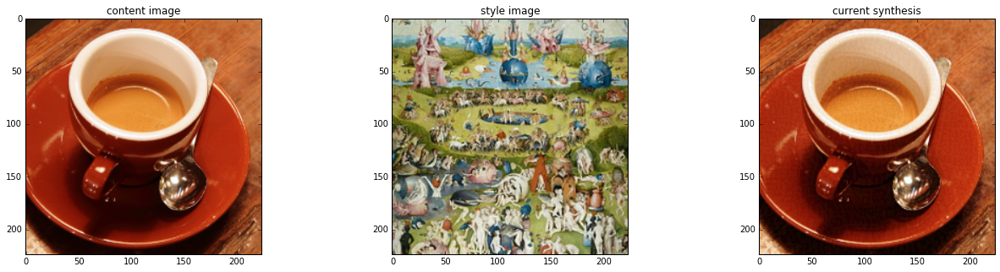

1: 41.527805, (-0.019984 - 1.020013)
2: 36.726242, (-0.029970 - 1.030036)
3: 33.132301, (-0.039943 - 1.040036)
4: 30.825277, (-0.049814 - 1.049982)
5: 29.472797, (-0.059614 - 1.059739)


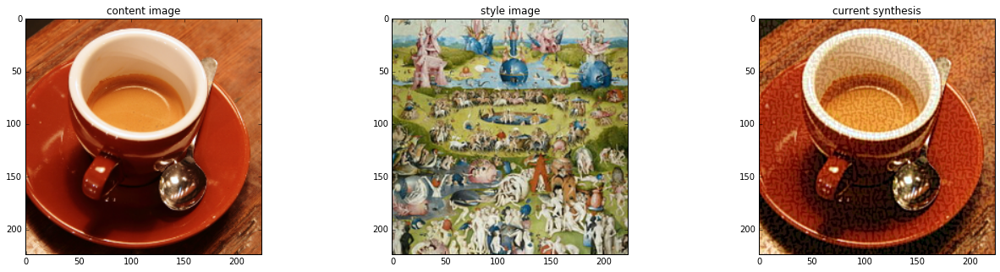

6: 28.482155, (-0.069084 - 1.069270)
7: 27.398533, (-0.078122 - 1.078805)
8: 26.078959, (-0.086861 - 1.088219)
9: 24.599209, (-0.096156 - 1.097538)
10: 23.106552, (-0.104688 - 1.106785)


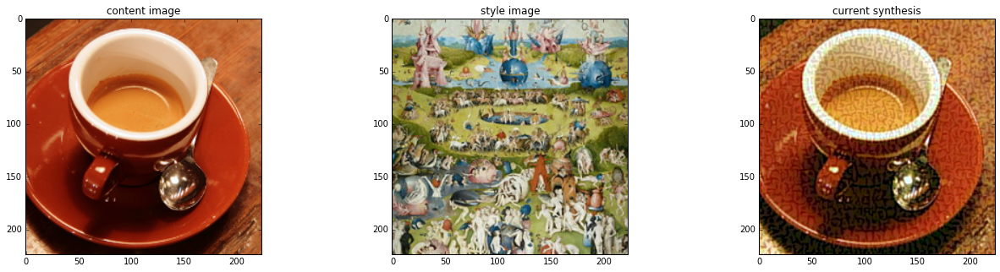

11: 21.728117, (-0.112565 - 1.116050)
12: 20.532927, (-0.121970 - 1.125387)
13: 19.527969, (-0.132242 - 1.134813)
14: 18.680058, (-0.142458 - 1.144342)
15: 17.944118, (-0.152462 - 1.153988)


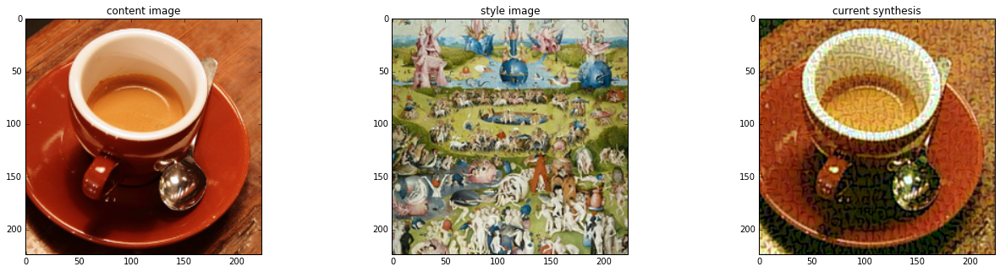

16: 17.281269, (-0.162253 - 1.163744)
17: 16.672457, (-0.171585 - 1.173564)
18: 16.113823, (-0.179913 - 1.183393)
19: 15.612597, (-0.186531 - 1.193166)
20: 15.175312, (-0.190814 - 1.202783)


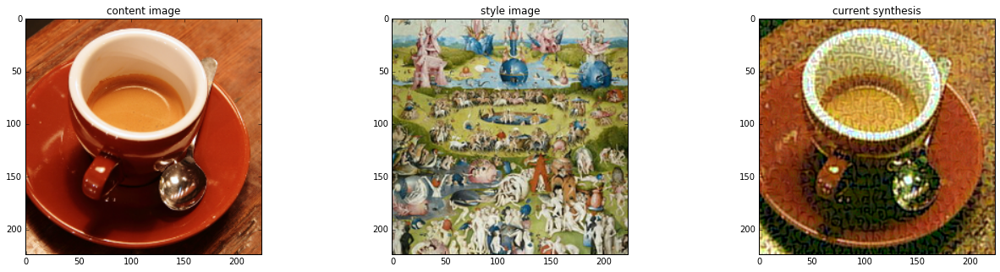

21: 14.799221, (-0.193791 - 1.212068)
22: 14.471707, (-0.202589 - 1.220960)
23: 14.174005, (-0.210879 - 1.229360)
24: 13.889018, (-0.218521 - 1.237175)
25: 13.608907, (-0.225438 - 1.244390)


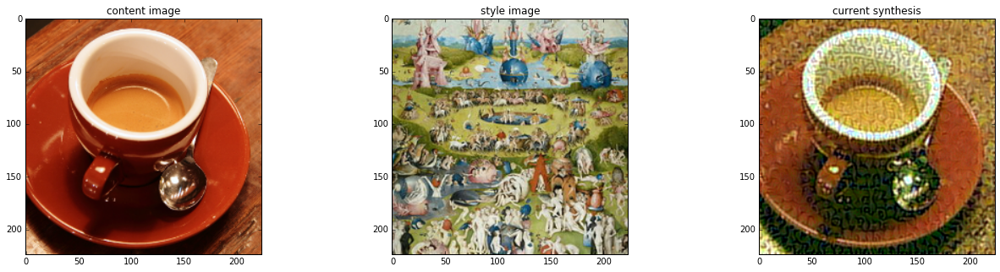

26: 13.335546, (-0.231610 - 1.251005)
27: 13.076498, (-0.237120 - 1.257057)
28: 12.839410, (-0.242065 - 1.262578)
29: 12.627560, (-0.246453 - 1.267609)
30: 12.438450, (-0.250359 - 1.272232)


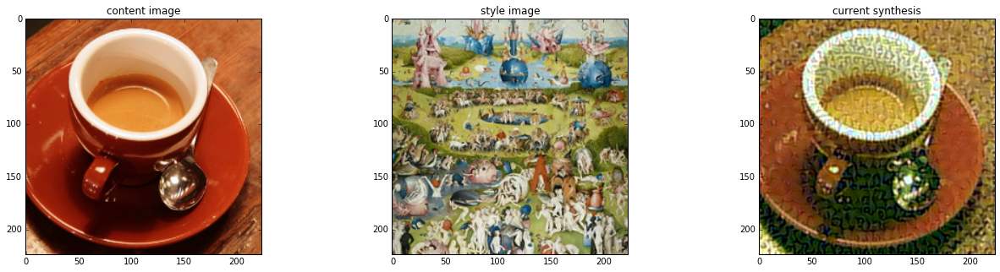

31: 12.266417, (-0.253853 - 1.276482)
32: 12.105091, (-0.256894 - 1.280326)
33: 11.950727, (-0.264070 - 1.283617)
34: 11.802845, (-0.273506 - 1.286333)
35: 11.663670, (-0.282830 - 1.291337)


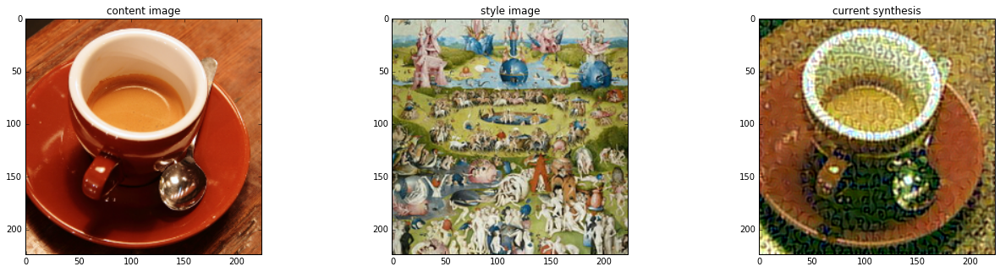

36: 11.535501, (-0.291971 - 1.297106)
37: 11.419305, (-0.300841 - 1.302230)
38: 11.313501, (-0.309364 - 1.306639)
39: 11.214956, (-0.317482 - 1.310291)
40: 11.120373, (-0.325157 - 1.313208)


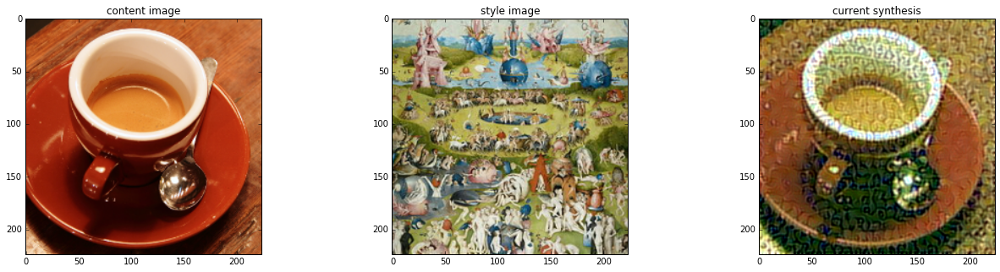

41: 11.028181, (-0.332392 - 1.315448)
42: 10.938995, (-0.339203 - 1.317093)
43: 10.854811, (-0.345624 - 1.318280)
44: 10.776907, (-0.351696 - 1.319143)
45: 10.705124, (-0.357446 - 1.319765)


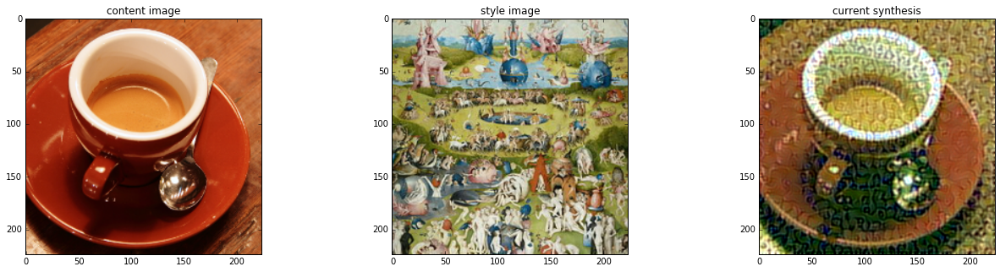

46: 10.638214, (-0.362892 - 1.320251)
47: 10.574605, (-0.368022 - 1.320665)
48: 10.513269, (-0.372818 - 1.321053)
49: 10.454495, (-0.377236 - 1.321387)
50: 10.398926, (-0.381224 - 1.321625)


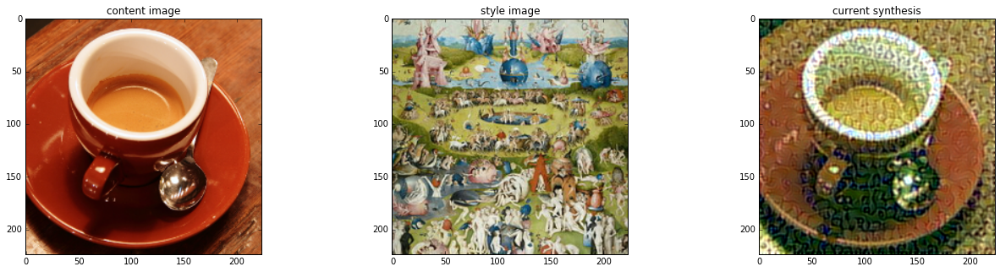

51: 10.346942, (-0.384715 - 1.322742)
52: 10.298336, (-0.387667 - 1.327233)
53: 10.252294, (-0.390061 - 1.331752)
54: 10.207791, (-0.391895 - 1.339223)
55: 10.164473, (-0.393215 - 1.346594)


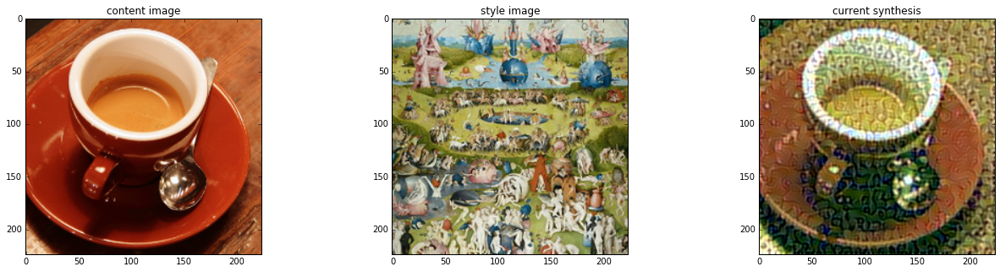

56: 10.122510, (-0.394063 - 1.353848)
57: 10.082338, (-0.394505 - 1.361039)
58: 10.044279, (-0.394610 - 1.368173)
59: 10.008223, (-0.394434 - 1.375257)
60: 9.973778, (-0.394023 - 1.382314)


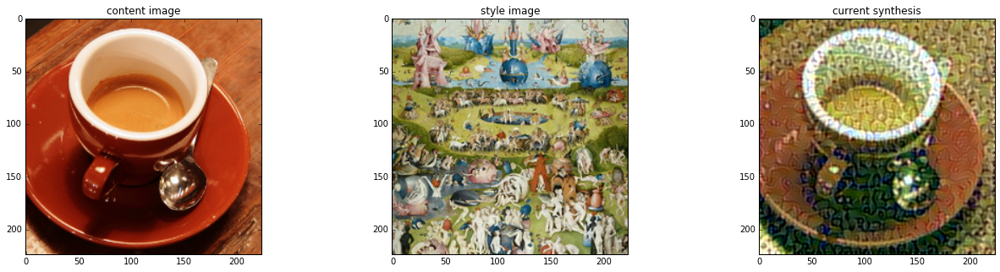

61: 9.940480, (-0.393409 - 1.389303)
62: 9.908276, (-0.392608 - 1.396200)
63: 9.877314, (-0.391608 - 1.402997)
64: 9.847815, (-0.390402 - 1.409703)
65: 9.819736, (-0.388995 - 1.416255)


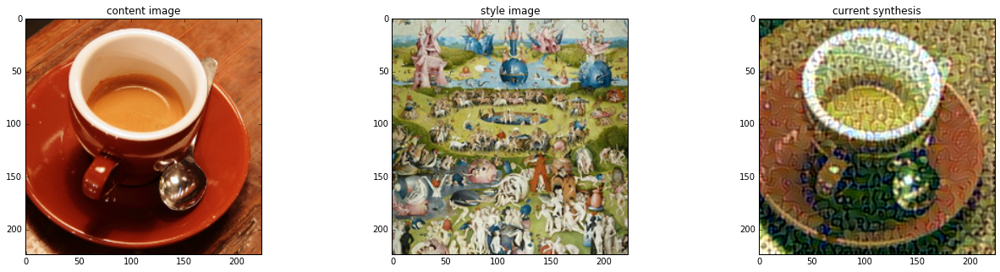

66: 9.792754, (-0.387381 - 1.422586)
67: 9.766596, (-0.385586 - 1.428678)
68: 9.741144, (-0.384339 - 1.434477)
69: 9.716408, (-0.396202 - 1.439959)
70: 9.692583, (-0.408149 - 1.445198)


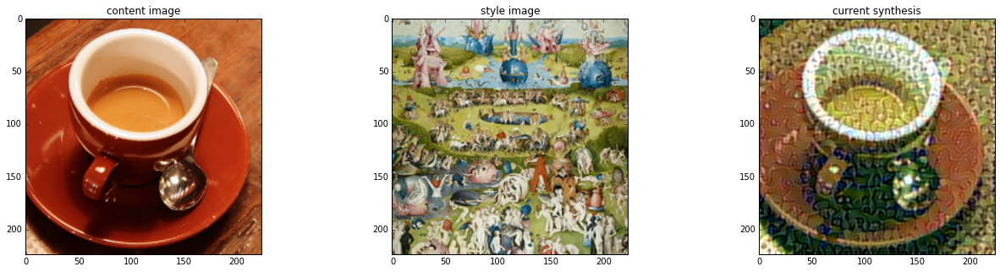

71: 9.669689, (-0.420201 - 1.450209)
72: 9.647569, (-0.432363 - 1.455014)
73: 9.626028, (-0.444627 - 1.459660)
74: 9.605102, (-0.456983 - 1.464140)
75: 9.584824, (-0.469422 - 1.468347)


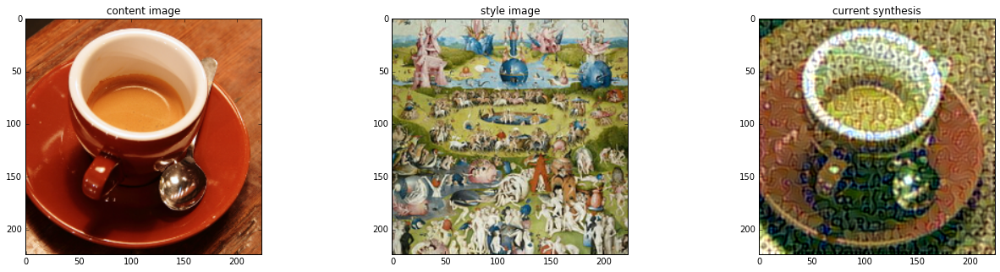

76: 9.565211, (-0.481931 - 1.472192)
77: 9.546281, (-0.494502 - 1.475690)
78: 9.527858, (-0.507132 - 1.478889)
79: 9.509901, (-0.519812 - 1.481811)
80: 9.492346, (-0.532554 - 1.484594)


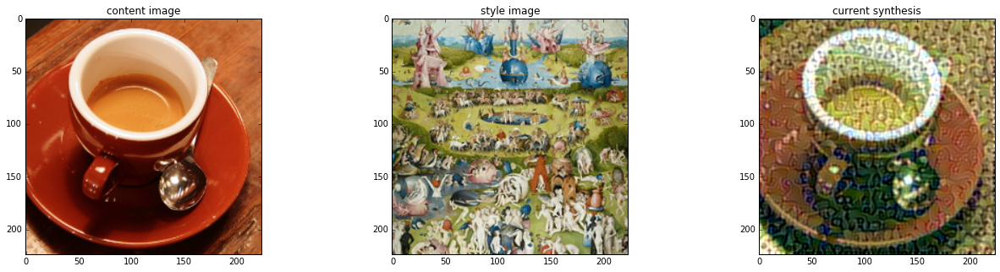

81: 9.475199, (-0.545363 - 1.487275)
82: 9.458512, (-0.558239 - 1.489857)
83: 9.442279, (-0.571179 - 1.492366)
84: 9.426536, (-0.584182 - 1.494845)
85: 9.411205, (-0.597234 - 1.497312)


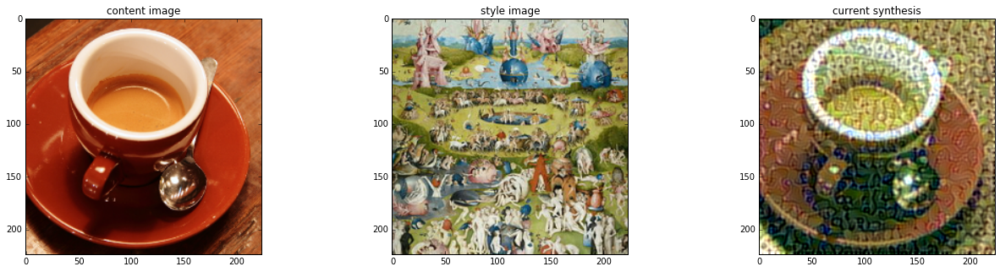

86: 9.396239, (-0.610334 - 1.501728)
87: 9.381626, (-0.623471 - 1.509634)
88: 9.367407, (-0.636638 - 1.517822)
89: 9.353575, (-0.649831 - 1.525973)
90: 9.340040, (-0.663042 - 1.533923)


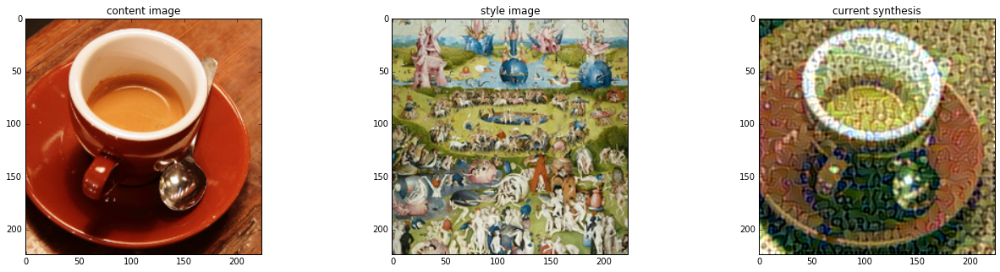

91: 9.326790, (-0.676278 - 1.541619)
92: 9.313822, (-0.689538 - 1.549024)
93: 9.301157, (-0.702835 - 1.556171)
94: 9.288795, (-0.716173 - 1.563234)
95: 9.276705, (-0.729558 - 1.570207)


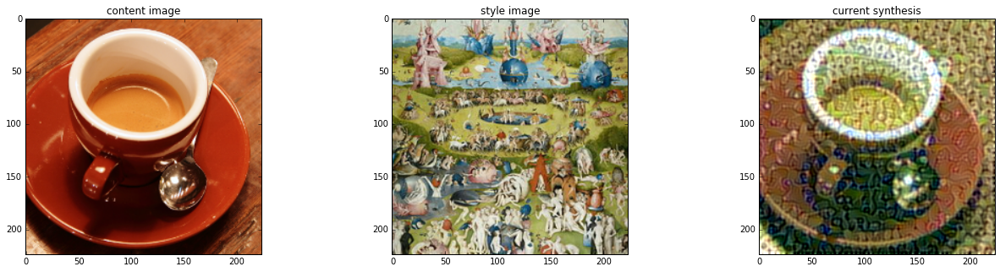

96: 9.264882, (-0.742992 - 1.577089)
97: 9.253311, (-0.756464 - 1.583826)
98: 9.241951, (-0.769972 - 1.590389)
99: 9.230789, (-0.783518 - 1.596775)


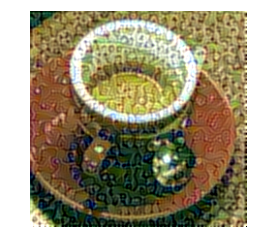

In [33]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    sess.run(tf.initialize_all_variables())
    # map input to noise
    n_iterations = 100
    og_img = net_input.eval()
    imgs = []
    for it_i in range(n_iterations):
        _, this_loss, synth = sess.run([optimizer, loss, net_input],
                feed_dict={
                    'vgg/dropout_1/random_uniform:0':
                        np.ones(g.get_tensor_by_name(
                        'vgg/dropout_1/random_uniform:0').get_shape().as_list()),
                    'vgg/dropout/random_uniform:0':
                        np.ones(g.get_tensor_by_name(
                        'vgg/dropout/random_uniform:0').get_shape().as_list())})
        print("%d: %f, (%f - %f)" %
            (it_i, this_loss, np.min(synth), np.max(synth)))
        if it_i % 5 == 0:
            imgs.append(np.clip(synth[0], 0, 1))
            fig, ax = plt.subplots(1, 3, figsize=(22, 5))
            ax[0].imshow(vgg16.deprocess(img))
            ax[0].set_title('content image')
            ax[1].imshow(vgg16.deprocess(style_img))
            ax[1].set_title('style image')
            ax[2].set_title('current synthesis')
            ax[2].imshow(vgg16.deprocess(synth[0]))
            plt.show()
            fig.canvas.draw()
    gif.build_gif(imgs, saveto='stylenet-bosch.gif')

In [34]:
ipyd.Image(url='stylenet-bosch.gif', height=300, width=300)

We can play with a lot of the parameters involved to produce wildly different results.  There are also a lot of extensions to what I've presented here currently in the literature including incorporating structure, temporal constraints, variational constraints, and other regularizing methods including making use of the activations in the content image to help infer what features in the gram matrix are relevant.

There is also no reason I can see why this approach wouldn't work with using different sets of layers or different networks entirely such as the Inception network we started with in this session.  Perhaps after exploring deep representations a bit more, you might find intuition towards which networks, layers, or neurons in particular represent the aspects of the style you want to bring out.  You might even try blending different sets of neurons to produce interesting results.  Play with different motions.  Try blending the results as you produce the deep dream with other content.

Also, there is no reason you have to start with an image of noise, or an image of the content.  Perhaps you can start with an entirely different image which tries to reflect the process you are interested in.  There are also a lot of interesting published extensions to this technique including image analogies, neural doodle, incorporating structure, and incorporating temporal losses from optical flow to stylize video.

There is certainly a lot of room to explore within technique.  A good starting place for the possibilities with the basic version of style net I've shown here is Kyle McDonald's Style Studies:

http://www.kylemcdonald.net/stylestudies/

If you find other interesting applications of the technique, feel free to post them on the forums.

<TODO: Neural Doodle, Semantic Style Transfer>

<a name="homework"></a>
# Homework

* GIF of deep dream
* GIF of stylenet
* Combine a Deep Dream and a Style Net together.

- Peer assessed
- Gallery commenting

<a name="reading"></a>
# Reading

Matthew D Zeiler, Rob Fergus.  Visualizing and Understanding Convolutional Networks.  2013.
https://arxiv.org/abs/1311.2901

Karen Simonyan, Andrea Vedaldi, Andrew Zisserman.  Deep Inside Convolutional Networks: Visualising Image Classification Models and Saliency Maps. 2013.

Aravindh Mahendran, Andrea Vedaldi.  Understanding Deep Image Representations by Inverting Them.  2014.
https://arxiv.org/abs/1412.0035

Mordvintsev, Alexander; Olah, Christopher; Tyka, Mike (2015). "Inceptionism: Going Deeper into Neural Networks". Google Research. Archived from the original on 2015-07-03.

Szegedy, Christian; Liu, Wei; Jia, Yangqing; Sermanet, Pierre; Reed, Scott; Anguelov, Dragomir; Erhan, Dumitru; Vanhoucke, Vincent; Rabinovich, Andrew (2014). "Going Deeper with Convolutions". Computing Research Repository. arXiv:1409.4842.

Leon A. Gatys, Alexander S. Ecker, Matthias Bethge. 
A Neural Algorithm of Artistic Style.  2015.  https://arxiv.org/abs/1508.06576

Texture Networks.
http://jmlr.org/proceedings/papers/v48/ulyanov16.pdf

Jost Tobias Springenberg, Alexey Dosovitskiy, Thomas Brox, Martin Riedmiller.  Striving for Simplicity: The All Convolutional Net.  2015.
https://arxiv.org/abs/1412.6806

Yosinski, J., Clune, J., Nguyen, A., Fuchs, T., Lipson, H.  Understanding Neural Networks Through Deep Visualization.  ICML.  2015.
http://yosinski.com/media/papers/Yosinski__2015__ICML_DL__Understanding_Neural_Networks_Through_Deep_Visualization__.pdf